## 1. Dataset Creation

In [1]:
%load_ext autoreload
%autoreload 2

This notebook should serve as a guide to the creation of your Carnatic Music Instrument dataset. We will start with the loading of the dataset using the mirdata API, extract the relevant sections and instruments, apply any relevant processing steps, and store the dataset in an intuitive and accessible format.

Typical Carnatic Music ensembles contain a wide-range of instruments. For this task we are going to focus on:

- Voice
- Violin
- Mridangam

You can refer to the instrumentation section of the [compIAM tutorial](https://mtg.github.io/IAM-tutorial-ismir22/indian_art_music/carnatic-music.html) for more information.

The final dataset will be a collection of short audios corresponding to each of these instruments. They will be organised such that each can be retrieved according to the instrument they contain, the performer, the raga and a unique identifier (for reproducibility later).

It is up to you to fill in each subsection with the relevant code to perform that task. If possible, try and split the sections amongst the project group to work in parallel. When the task is complete, you should try and abstract the code into .py files so that it can be ran without a python notebook.

### Explore Dataset

You can access the Saraga Carnatic dataset using the [mirdata API](https://github.com/mir-dataset-loaders/mirdata). You should already have the dataset downloaded on your machine in the mirdata repository.

In [5]:
!pip install mirdata


[notice] A new release of pip is available: 24.0 -> 25.1.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [2]:
import mirdata

In [ ]:

from google.colab import drive
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


In [3]:
data_home = 'G:\.shortcut-targets-by-id\17yphSXB2IgKWLJF-VDo9xJDWWM2e6mkH\S104\dataset\saraga1.5_carnatic'

In [ ]:
#Biel
data_home = '/content/drive/MyDrive/S104/dataset'

In [8]:
! pwd

"pwd" no se reconoce como un comando interno o externo,
programa o archivo por lotes ejecutable.


In [4]:
saraga = mirdata.initialize('saraga_carnatic', data_home=data_home)
#saraga.download(cleanup=False)
#saraga.validate(index=True)

In [9]:
! ls /usr/local/lib/python3.11/dist-packages/mirdata/datasets/

"ls" no se reconoce como un comando interno o externo,
programa o archivo por lotes ejecutable.


In [ ]:
! mkdir /usr/local/lib/python3.11/dist-packages/mirdata/datasets/indexes/
! cp "G:\.shortcut-targets-by-id\17yphSXB2IgKWLJF-VDo9xJDWWM2e6mkH\S104\dataset\saraga_carnatic_index_1.5.json" "/usr/local/lib/python3.11/dist-packages/mirdata/datasets/indexes/saraga_carnatic_index_1.5.json"

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

In [ ]:
saraga.validate()

  0%|          | 0/249 [00:02<?, ?it/s]


KeyboardInterrupt: 

You can choose a random track using `.choice_track()`. This returns a Track object.

In [6]:
example_track = saraga.choice_track()
print(example_track)

Track(
  audio_ghatam_path=None,
  audio_mridangam_left_path=None,
  audio_mridangam_right_path=None,
  audio_path="...Sastri Hall by Sanjay Subrahmanyan/Vanajakshi - Varnam/Sanjay Subrahmanyan - Vanajakshi - Varnam.mp3",
  audio_violin_path=None,
  audio_vocal_path=None,
  audio_vocal_s_path=None,
  ctonic_path="...Hall by Sanjay Subrahmanyan/Vanajakshi - Varnam/Sanjay Subrahmanyan - Vanajakshi - Varnam.ctonic.txt",
  metadata_path="...astri Hall by Sanjay Subrahmanyan/Vanajakshi - Varnam/Sanjay Subrahmanyan - Vanajakshi - Varnam.json",
  phrases_path="...anjay Subrahmanyan/Vanajakshi - Varnam/Sanjay Subrahmanyan - Vanajakshi - Varnam.mphrases-manual.txt",
  pitch_path="... Hall by Sanjay Subrahmanyan/Vanajakshi - Varnam/Sanjay Subrahmanyan - Vanajakshi - Varnam.pitch.txt",
  pitch_vocal_path=None,
  sama_path="...by Sanjay Subrahmanyan/Vanajakshi - Varnam/Sanjay Subrahmanyan - Vanajakshi - Varnam.sama-manual.txt",
  sections_path="...jay Subrahmanyan/Vanajakshi - Varnam/Sanjay Subrah

You can load all tracks and information to a dict using `.load_tracks()`

In [ ]:
all_tracks = saraga.load_tracks()

This returns a dict of `unique track identifier` : `track` object for each track.

Track objects contain all filepaths of audios and metadata associated with the chosen track, and some information related to the recording itself (such as artist names and instruments). Remember, that for many recordings, we have 4 audio files relevant to our task...


The path of the final mixed performance:

In [ ]:
example_track.audio_path

The path of the vocal microphone:

In [ ]:
example_track.audio_vocal_path

The path of the violin microphone:

In [ ]:
example_track.audio_violin_path

And two mridangam microphones (one for each head):

In [ ]:
example_track.audio_mridangam_left_path

In [ ]:
example_track.audio_mridangam_right_path

Navigate to these files and listen to the audios. What do you notice about them? Are they the same intensity? Is there any undesirable artifacts such as leaking or noise?

Take note, the `mirdata` `Track` object will not have a `audio_vocal_path` (or vocal or mridangam) attribute if for the given track there is no multi-microphone recordings. Can you use this information to determine how many tracks we have multi-microphone recordings for? (HINT: You can check if an object has a specific attribute using the hasattr function: `hasattr(obj, "<attribute_to_check_for>")`.

In [ ]:
# How many tracks with multitrack recordings?

Another important path is the metadata_path:

In [ ]:
metadata_path = example_track.metadata_path

Here you will find information relating to the recording such as artist names, instruments, raaga.

Can you create some functions to explore these tracks and metadata? Perhaps it would be useful to know that JSON can be loaded in python using the `json` library:

In [ ]:

json_path = track.metadata_path

In [ ]:
import json

with open(json_path, 'r') as f:
    loaded_json = json.loads(f.read())

In [ ]:
import pandas as pd
import json
def get_metadata(track_id):
    """
    For <track_id>, return a dataframe of associated metadata
    """
    track = saraga.track(track_id)

    with open(track.metadata_path, 'r') as f:
        json_data = json.load(f)

    json_data["track_id"] = track.track_id

    formatted_metadata = json.dumps(json_data, indent=4)


    return print(formatted_metadata)


def get_performer(track_id):
    """
    For <track_id>, return the performer
    """
    track = saraga.track(track_id)

    with open(track.metadata_path, 'r') as f:
        json_data = json.load(f)

    performer = json_data.get("artists")
    return performer

def get_performance(track_id):
    """
    For <track_id>, return the performance name
    """
    track = saraga.track(track_id)

    with open(track.metadata_path, 'r') as f:
        json_data = json.load(f)

    performance = json_data.get("concert")
    return performance

def get_raga(track_id):
    """
    For <track_id>, return the raga name
    """
    track = saraga.track(track_id)

    with open(track.metadata_path, 'r') as f:
        json_data = json.load(f)

    raga = json_data.get("raaga")
    return raga


def get_tonic(track_id):
    """
    For <track_id>, return the tonic in hertz
    """
    track = saraga.track(track_id)

    with open(track.ctonic_path, 'r') as f:
        tonic = float(f.read().strip())



    return tonic

In [ ]:
get_tonic(example_track.track_id)

130.812783

How many ragas/performers/performances are available? How does that breakdown across performances for which we have multi-track recordings and those we dont?

In [ ]:
import pandas as pd

def get_track_info(track_id):

    track = saraga.track(track_id)

    # Extract metadata using functions
    raga = get_raga(track_id)
    performer = get_performer(track_id)[0] if get_performer(track_id) else None  # Handle cases with no artist info
    performance = get_performance(track_id)
    multitrack = hasattr(track, "audio_vocal_path")

    return {
        "track_id": track_id,
        "raga": raga,
        "performer": performer,
        "performance": performance,
        "multitrack": multitrack
    }

In [ ]:
get_track_info(example_track.track_id)

{'track_id': '248_Gange_Maampahi',
 'raga': [],
 'performer': {'instrument': {'mbid': 'f689271c-37bc-4c49-92a3-a14b15ee5d0e',
   'name': 'Mridangam'},
  'attributes': '',
  'lead': False,
  'artist': {'mbid': '07b755f5-9202-42fe-81a8-820af66d2f51',
   'name': 'B Sivaraman'}},
 'performance': [{'mbid': 'f0784dac-a546-402f-9ade-c5765b4179ee',
   'title': 'Chaitra Sairam at Arkay'}],
 'multitrack': True}

### Load Audio

The mirdata API returns paths to audio files associated with each track. Can you create some loaders to load an audio based on a given track name?

**Hint**: The `librosa` library contains functions to load audio from file to an array of amplitude values. `y, sr = librosa.load(audio_path, sr=44100)`. `sr` in this instance refers to the sampling rate of the audio, i.e. how many individual amplitude energy values there are per second (typically 44100Hz). It is important to remember this resolution when converting between number of elements in the returned array and time in the track.

In [ ]:
import librosa

def load_mixed_audio(track_id):
    """
    For <track_id>, return the loaded audio
    """
    track = saraga.track(track_id)
    audio_array, sr = librosa.load(track.audio_path, sr=44100)
    return audio_array

def load_violin_audio(track_id):
    """
    For <track_id>, return the isolated violin track
    """

    track = saraga.track(track_id)

    if track.audio_violin_path is None:
            print(f"Warning: No violin audio for track {track_id}")
            return None

    audio_array, sr = librosa.load(track.audio_violin_path, sr=44100)
    return audio_array

def load_voice_audio(track_id):
    """
    For <track_id>, return the isolated voice track
    """
    track = saraga.track(track_id)

    if track.audio_vocal_path is None:
            print(f"Warning: No voice audio for track {track_id}")
            return None

    audio_array, sr = librosa.load(track.audio_vocal_path, sr=44100)
    return audio_array

def load_mridangam_left_audio(track_id):
    """
    For <track_id>, return the isolated mridangam track
    """
    track = saraga.track(track_id)

    if track.audio_mridangam_left_path is None:
            print(f"Warning: No left mridangam audio for track {track_id}")
            return None

    audio_array, sr = librosa.load(track.audio_mridangam_left_path, sr=44100)

    return audio_array

def load_mridangam_right_audio(track_id):
    """
    For <track_id>, return the isolated mridangam track
    """
    track = saraga.track(track_id)

    if track.audio_mridangam_right_path is None:
            print(f"Warning: No right mridangam audio for track {track_id}")
            return None

    audio_array, sr = librosa.load(track.audio_mridangam_right_path, sr=44100)

    return audio_array

In [ ]:
load_voice_audio(example_track.track_id)

array([-1.3695963e-04, -9.2611233e-05, -1.9303112e-05, ...,
        2.4869974e-04,  3.4970380e-04,  2.6019959e-04], dtype=float32)

### Listen to Audio

Let's write some functions to listen and visualise these audio arrays in the notebook.

**Hint**: You should find that the `Ipythoon.display.Audio` useful for playing audio inline in a Jupyter notebook.

**Hint2**: Using the `matplotlib` library you can plot on two dimensions as so:

```
import matplotlib.pyplot as plt

plt.plot(x, y)
```
More information on enhancing these plots (e.g. with titles, axis labels and gridlines) can be found [here](https://matplotlib.org/stable/gallery/lines_bars_and_markers/simple_plot.html).

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from IPython.display import Audio

def plot_waveform(audio_array, sr=44100):
    """
    Plot waveform for <audio_array> using matplotlib.pyplot
    """
    # Create time axis
    time = np.arange(len(audio_array)) / sr

    # Plot the waveform
    plt.plot(time, audio_array)
    plt.xlabel("Time (seconds)")
    plt.ylabel("Amplitude")
    plt.title("Audio Waveform")
    plt.grid(True)
    plt.show()

def play_audio(audio_array, sr=44100):
    """
    Generate audio player for <audio_array> using Ipython library
    """
    display(Audio(audio_array, rate=sr))

In [ ]:
play_audio(load_voice_audio(example_track.track_id))

Are there any important observations about the mixed or isolated instrument tracks? What is the quality like, do you here all of the instruments clearly? Are there any differences between the audios of the individual instrument tracks?

### Processing

Are the isolated vocal tracks sufficiently isolated? Libraries like [`spleeter`](https://github.com/deezer/spleeter) can help separate singing sources from background instruments. Does it help here?

In [ ]:
!pip install spleeter

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 45.6/45.6 kB 2.8 MB/s eta 0:00:00
INFO: pip is looking at multiple versions of jax to determine which version is compatible with other requirements. This could take a while.
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 48.7/48.7 kB 3.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 585.9/585.9 MB 3.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.4/2.4 MB 78.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 77.3/77.3 kB 6.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.3/17.3 MB 96.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.0/12.0 MB 105.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 82.8/82.8 kB 5.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 4.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 80.9/80.9 kB 6.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 82.5 MB/s eta 0:00:

In [ ]:
from spleeter.separator import Separator

def separate_voice(audio_path, isolated_audio_output_path):
    """
    Apply spleeter source separation to input audio
    """
    # Load spleeter model for voice separation
    separator = Separator('spleeter:2stems')

    # Perform separation
    separator.separate_to_file(audio_path, isolated_audio_output_path)

In [ ]:
separate_voice(example_track.audio_path, '/content/drive/MyDrive/dataset/outputs')


Instructions for updating:
Use tf.keras instead.
Instructions for updating:
Use tf.keras instead.
Instructions for updating:
Colocations handled automatically by placer.
Instructions for updating:
Use tf.keras instead.
Instructions for updating:
Use tf.keras instead.
Instructions for updating:
Use tf.keras instead.
Instructions for updating:
Use tf.keras instead.
Instructions for updating:
Use tf.keras instead.


INFO:spleeter:File /content/drive/MyDrive/dataset/outputs/Lalitha Lavanga.mp3/vocals.wav written succesfully


INFO:spleeter:File /content/drive/MyDrive/dataset/outputs/Lalitha Lavanga.mp3/vocals.wav written succesfully


INFO:spleeter:File /content/drive/MyDrive/dataset/outputs/Lalitha Lavanga.mp3/accompaniment.wav written succesfully


INFO:spleeter:File /content/drive/MyDrive/dataset/outputs/Lalitha Lavanga.mp3/accompaniment.wav written succesfully


How does the quality compare? Does spleeter work effectively? Do we lose any important information?

### Tagging Audio

We want to tag our audios with whether or not a particular instrument is sounding. We can do this by identifying non-silent regions in the isolated tracks and tagging the mixed tracks with the instrument. The `librosa` library contains functionality for identifying silent regions in audio (`librosa.effects.split`).

In [ ]:
# Load audios for each instrument track using previously defined functions

mix_array = load_mixed_audio(example_track.track_id)
vocal_array = load_voice_audio(example_track.track_id)
violin_array = load_violin_audio(example_track.track_id)
mridangam_left_array = load_mridangam_left_audio(example_track.track_id)
mridangam_right_array = load_mridangam_right_audio(example_track.track_id)

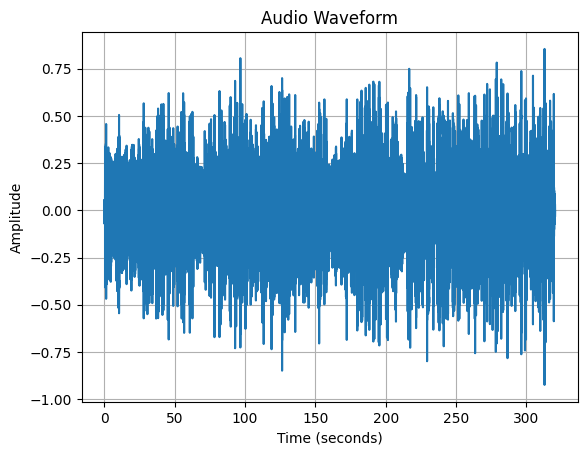

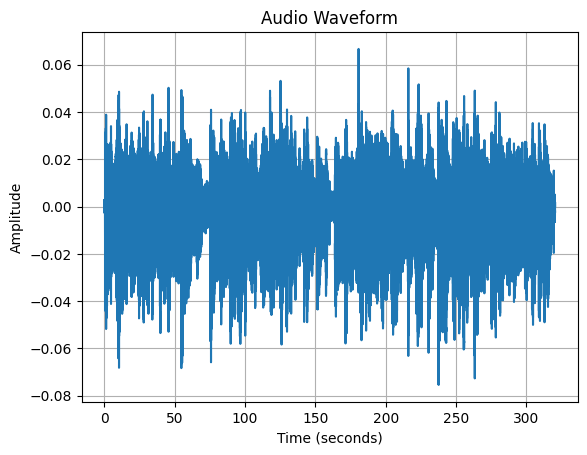

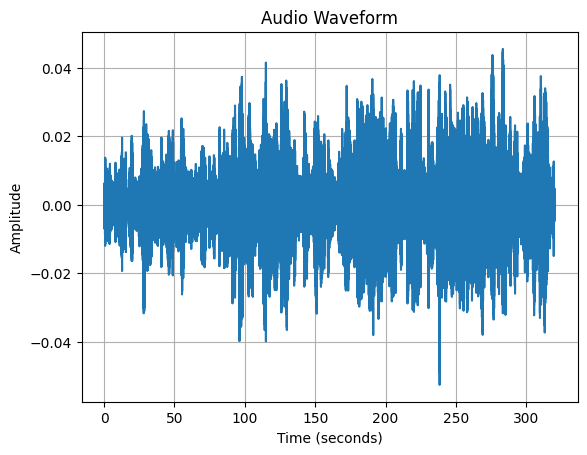

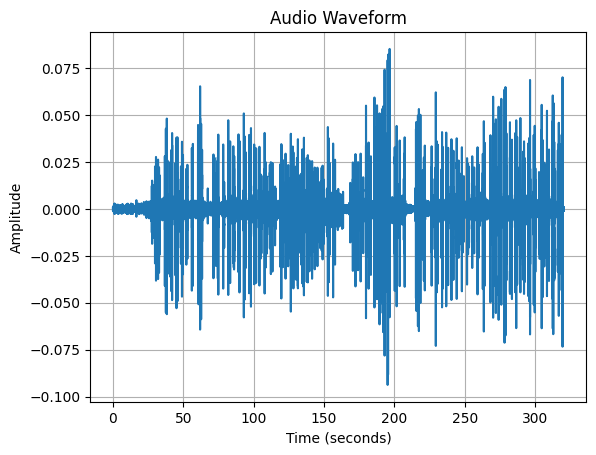

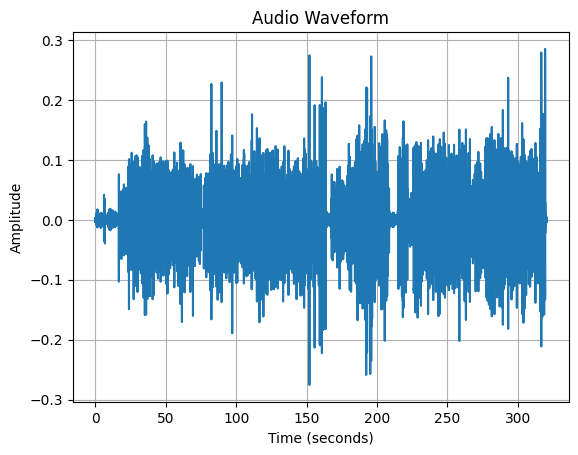

In [ ]:
# Plot samples of audios (remember the relationship between elements and sampling rate)

plot_waveform(mix_array, sr=44100)
plot_waveform(vocal_array, sr=44100)
plot_waveform(violin_array, sr=44100)
plot_waveform(mridangam_left_array, sr=44100)
plot_waveform(mridangam_right_array, sr=44100)

Define a function to identify silent regions in an audio array. Look at the documentation for `librosa.effects.split` ([here](https://librosa.org/doc/main/generated/librosa.effects.split.html)).

**Hint** - The `top_db` parameter tunes the harshness of the cut (a higher value considers louder regions as "silent"). Experiment with this value and compare the results with the audio plots. Do they correspond to what you visualise/hear?

**Remember** - `librosa.effects.split` returns NON-silent intervals.

In [ ]:
import librosa

def detect_silence(audio_array, top_db=20):
    """
    Return array of 0 and 1 (is silent/is not silent) for input <audio_array>.
    Returned array should be equal in length to input array.
    """
    # Detect non-silent intervals
    non_silent_intervals = librosa.effects.split(audio_array, top_db=top_db)

    # Create an array of zeros with the same length as the audio array
    is_silent = np.zeros(len(audio_array))

    # Mark non-silent regions as 1
    for start, end in non_silent_intervals:
        is_silent[start:end] = 1

    return is_silent

Do these regions correspond to what you hear when playing the audio with `play_audio` or what you see with `plot_waveform`?

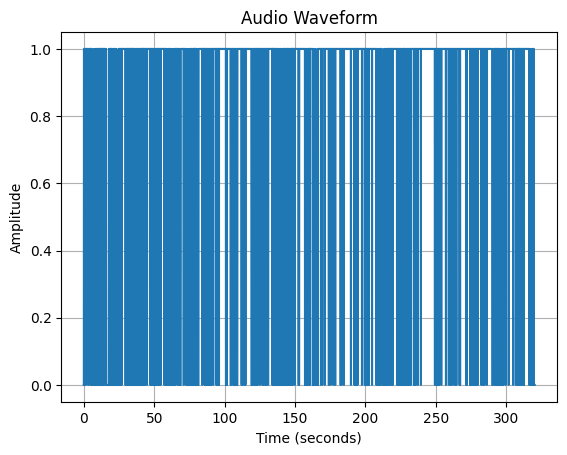

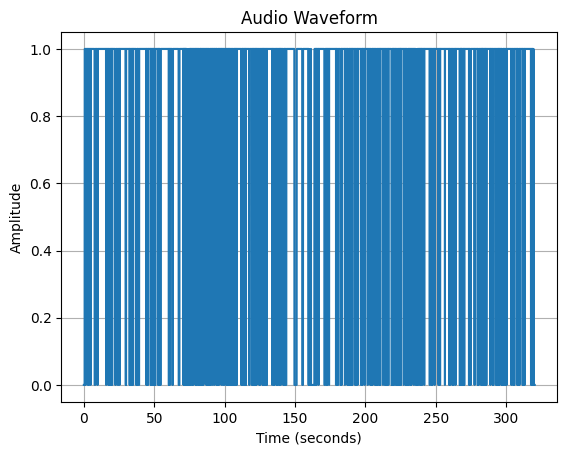

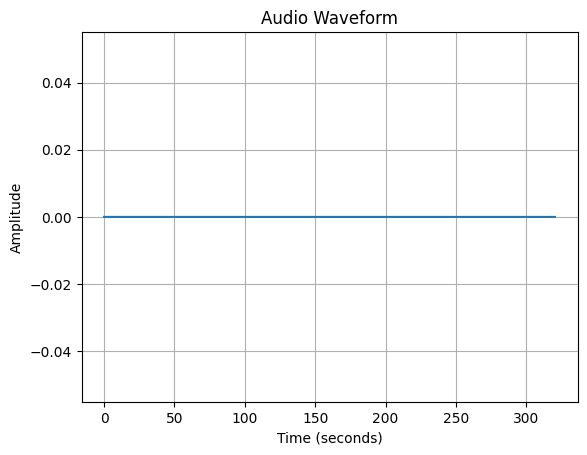

In [ ]:
violin_silence = detect_silence(violin_array)
vocal_silence = detect_silence(vocal_array)

mridangam = [int(x or y) for x,y in zip(mridangam_left_array, mridangam_right_array)]

plot_waveform(violin_silence, sr=44100)
plot_waveform(vocal_silence, sr=44100)
plot_waveform(mridangam, sr=44100)

### Extracting Samples

We should now have all the tools necessary to load and annotated audio. We now want to extract small snippets of audio  from the mixed tracks across the dataset and annotate each of these snippets as either containing voice, mridangam, violin or none of the above (a single audio should be able to have more than one tag).

It is important that we have examples for all combinations of tags (violin, voice, mridangam, none). Each sample should be of the same length (what should that length be? think about the two extreme cases of very very short and very long, what problems would arise in each of these cases).

Each sample should have a unique identifier (index). The information relating to their tags should be stored in a metadata DataFrame where you can also find information about the performance.

These should all be saved in individual audio files.

Let us try with just on track to begin with...

1. For a certain track id, load all audio files (mix, violin, etc...)

In [ ]:
def load_all_audio(track_id):

    mix_array = load_mixed_audio(track_id)
    vocal_array = load_voice_audio(track_id)
    violin_array = load_violin_audio(track_id)
    mridangam_left_array = load_mridangam_left_audio(track_id)
    mridangam_right_array = load_mridangam_right_audio(track_id)

    return mix_array, vocal_array, violin_array, mridangam_left_array, mridangam_right_array

In [ ]:
mix_array, vocal_array, violin_array, mridangam_left_array, mridangam_right_array = load_all_audio(example_track.track_id)

2. Create a silent/non-silent array using `detect_silence()` defined earlier.

      **Remember**: The mridangam has two tracks corresponding to it, you must combine them to identify whether either is sounding

In [ ]:
violin_silence = detect_silence(violin_array)
vocal_silence = detect_silence(vocal_array)
mridangam_silence = np.logical_or(detect_silence(mridangam_left_array), detect_silence(mridangam_right_array)).astype(int)

3. Split mixed audio into small chunks using [numpy array indexing](https://numpy.org/doc/stable/user/basics.indexing.html) (the size of these chunks should be informed by the literature)

In [ ]:
import numpy as np

def split_audio_into_chunks(audio_array, chunk_size_seconds, sr=44100):

  chunk_size_samples = int(chunk_size_seconds * sr)
  num_chunks = len(audio_array) // chunk_size_samples
  chunks = [audio_array[i * chunk_size_samples:(i + 1) * chunk_size_samples]
            for i in range(num_chunks)]
  return chunks

In [ ]:

mix_audio_chunks = split_audio_into_chunks(mix_array, 5)
print(len(mix_audio_chunks))

64


4. Determine from your silent/non-silent arrays in Step 2 whether the chunk contains each instrument (voice, vocal, mridangam

In [ ]:
# Slice silence arrays identically to mix slice and determine yes/no does chunk contain instrument

import numpy as np

def chunk_contains_instrument(instrument_silence_array, chunk_start_sample, chunk_end_sample):

    chunk_slice = instrument_silence_array[chunk_start_sample:chunk_end_sample]
    return np.any(chunk_slice)  # Check if any sample in the chunk is non-silent

chunk_size_seconds = 5
sr = 44100

chunk_instrument_annotations = []
for i, chunk in enumerate(mix_audio_chunks):
    chunk_start_sample = i * int(chunk_size_seconds * sr)
    chunk_end_sample = (i + 1) * int(chunk_size_seconds * sr)

    contains_violin = chunk_contains_instrument(violin_silence, chunk_start_sample, chunk_end_sample)
    contains_vocal = chunk_contains_instrument(vocal_silence, chunk_start_sample, chunk_end_sample)
    contains_mridangam = chunk_contains_instrument(mridangam_silence, chunk_start_sample, chunk_end_sample)

    chunk_instrument_annotations.append({
        "chunk_index": i,
        "contains_violin": contains_violin,
        "contains_vocal": contains_vocal,
        "contains_mridangam": contains_mridangam
    })

In [ ]:
print(chunk_instrument_annotations)

[{'chunk_index': 0, 'contains_violin': True, 'contains_vocal': True, 'contains_mridangam': False}, {'chunk_index': 1, 'contains_violin': True, 'contains_vocal': True, 'contains_mridangam': True}, {'chunk_index': 2, 'contains_violin': True, 'contains_vocal': True, 'contains_mridangam': False}, {'chunk_index': 3, 'contains_violin': True, 'contains_vocal': True, 'contains_mridangam': True}, {'chunk_index': 4, 'contains_violin': True, 'contains_vocal': True, 'contains_mridangam': True}, {'chunk_index': 5, 'contains_violin': True, 'contains_vocal': True, 'contains_mridangam': True}, {'chunk_index': 6, 'contains_violin': True, 'contains_vocal': True, 'contains_mridangam': True}, {'chunk_index': 7, 'contains_violin': True, 'contains_vocal': True, 'contains_mridangam': True}, {'chunk_index': 8, 'contains_violin': True, 'contains_vocal': True, 'contains_mridangam': True}, {'chunk_index': 9, 'contains_violin': True, 'contains_vocal': True, 'contains_mridangam': True}, {'chunk_index': 10, 'contai

5. Save each audio with a unique index.

    **Hint**: Audio arrays can be saved to file using the `soundfile` library:
    `sf.write('<filename>.wav', <audio_array>, <sampling rate>)`
    
    **Remember**: Each audio chunk  needs to be assigned a unique index so as to be managed correctly later on. Feel free to use numbers, hashes or uuids

In [ ]:
# store audio with soundfile
import soundfile as sf
import os

def save_audio_chunk(audio_chunk, output_dir, chunk_index, sr=44100):

  os.makedirs(output_dir, exist_ok=True)  # Create output directory if it doesn't exist
  file_path = os.path.join(output_dir, f"chunk_{chunk_index}.wav")
  sf.write(file_path, audio_chunk, sr)


In [ ]:
output_directory = "/content/drive/MyDrive/dataset/audio_chunks"
for i, chunk in enumerate(mix_audio_chunks):
  save_audio_chunk(chunk, output_directory, i)

6. Add row to metadata table containing relevant track information, index, and instrument annotations.

    **Hint** - A `pandas` dataframe is a suitable place to store information relating to track and instrument annotations. You can create one using:

    `import pandas as pd`

    `df = pd.DataFrame(columns=<list of columns names>])`
    
    Add new rows using append:
    
    `df.append({dict of {column_name:value>, ignore_index=True)`
    
    And save using:
    
    `df.to_csv('<path.csv>', index=False)`
    
    **Remember** - This table should include the metadata relating to the track, the unique chunk index and a column indicating whether or not it includes each instrument
    

In [ ]:
# metadata dataframe
import pandas as pd

# Create an empty DataFrame to store metadata
metadata_df = pd.DataFrame(columns=[
    "track_id", "raga", "performer", "performance",
    "chunk_index", "contains_violin", "contains_vocal", "contains_mridangam"
])

for annotation in chunk_instrument_annotations:
    track_info = get_track_info(example_track.track_id)

    row_data = {**track_info, **annotation}

    metadata_df = pd.concat([metadata_df, pd.DataFrame([row_data])], ignore_index=True)

metadata_df.to_csv("/content/drive/MyDrive/dataset/metadata.csv", index=False)

<ipython-input-37-66516f4a8622>:15: FutureWarning: In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.
  metadata_df = pd.concat([metadata_df, pd.DataFrame([row_data])], ignore_index=True)
<ipython-input-37-66516f4a8622>:15: FutureWarning: In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.
  metadata_df = pd.concat([metadata_df, pd.DataFrame([row_data])], ignore_index=True)
<ipython-input-37-66516f4a8622>:15: FutureWarning: In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.
  metadata_df = pd.concat([metadata_df, pd.DataFrame([row_data])], ignore_index=True)
<ipython-input-37-66516f4a8622>:15: FutureWarning: In a future version, object-dtype columns with all-bool values w

7. Repeat for many tracks and many chunks. Now you have written the individual code to do this for one track/chunk. Let's combine this and apply to a large number of tracks/chunks. Storing each with a unique index and a row in the metadata dataframe.

### Load Dataset

With our dataset created and saved in an intuitive and accessible format. Let's create some loaders to load the files and get metadata.

In [ ]:
import librosa
import pandas as pd

def load_sample(index, metadata_path="/content/drive/MyDrive/dataset/metadata.csv", audio_dir="/content/drive/MyDrive/dataset/audio_chunks"):

    metadata_df = pd.read_csv(metadata_path)

    sample_row = metadata_df[metadata_df["chunk_index"] == index].iloc[0]

    audio_file_path = os.path.join(audio_dir, f"chunk_{index}.wav")

    audio_array, sr = librosa.load(audio_file_path, sr=44100)

    return audio_array, sr

def get_metadata(index, metadata_path="/content/drive/MyDrive/dataset/metadata.csv"):
    metadata_df = pd.read_csv(metadata_path)

    metadata = metadata_df[metadata_df["chunk_index"] == index].iloc[0]

    return metadata

In [ ]:
audio_array, sr = load_sample(0)
metadata = get_metadata(0)

print(f"Track ID: {metadata['track_id']}")
print(f"Raga: {metadata['raga']}")
print(f"Contains Violin: {metadata['contains_violin']}")

Track ID: 126_Lalitha_Lavanga
Raga: []
Contains Violin: True


Typically, when datasets are presented, they are accompanied by some stats detailing their size and constiuent parts. What stats can you tell us about our dataset? Think about: number of seconds, performers, performances, instruments, ragas, filesizes etc....

In [ ]:
# stats

import pandas as pd
import os

# Load the metadata
metadata_df = pd.read_csv("/content/drive/MyDrive/dataset/metadata.csv")

# Number of seconds
total_seconds = len(metadata_df) * 5  # Assuming each chunk is 5 seconds
print(f"Total seconds of audio: {total_seconds}")

# Performers
num_performers = metadata_df['performer'].nunique()
print(f"Number of unique performers: {num_performers}")

# Performances
num_performances = metadata_df['performance'].nunique()
print(f"Number of unique performances: {num_performances}")

# Instruments
instrument_counts = metadata_df[['contains_violin', 'contains_vocal', 'contains_mridangam']].sum()
print("Instrument counts:\n", instrument_counts)

# Ragas
raga_counts = metadata_df['raga'].value_counts()
print("Raga counts:\n", raga_counts)

# Filesizes
total_filesize = 0
for filename in os.listdir("/content/drive/MyDrive/dataset/audio_chunks"):
    if filename.endswith(".wav"):
        filepath = os.path.join("/content/drive/MyDrive/dataset/audio_chunks", filename)
        total_filesize += os.path.getsize(filepath)

print(f"Total filesize of audio chunks (bytes): {total_filesize}")

Total seconds of audio: 320
Number of unique performers: 1
Number of unique performances: 1
Instrument counts:
 contains_violin       64
contains_vocal        64
contains_mridangam    61
dtype: int64
Raga counts:
 []    64
Name: raga, dtype: int64
Total filesize of audio chunks (bytes): 28226816


### Reproducible Code

Jupyter notebooks are great for experimenting, especially when visualisation or audio playback is required. However they are not great for reproducibility or source control. Can you abstract the code created here to .py file(s) so that the code can be ran in future without having to load the HTML notebook?